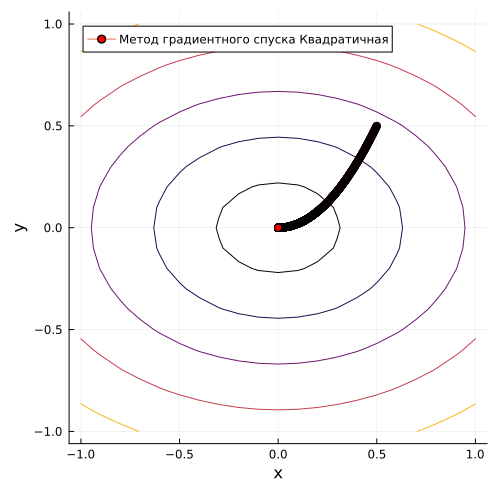

[МГС] Точка минимума: [4.948450931537779e-7, -4.999513968439592e-9]; Количество итераций: 6901
[МНС] Точка минимума: [6.686366069428981e-6, -1.671257030015508e-6]; Количество итераций: 9
[МСГ] Точка минимума: [2.951092822099107e-7, 8.454582804410364e-8]; Количество итераций: 2
[МГС] Точка минимума: [0.9999958770723749, 0.9999917446881579]; Количество итераций: 30498
[МНС] Точка минимума: [0.9995883905538449, 0.9991743950251759]; Количество итераций: 7090
[МСГ] Точка минимума: [0.9997207287698139, 0.999439936290825]; Количество итераций: 9
[МГС] Точка минимума: [5.239171129131137, 5.239171129131137]; Количество итераций: 30390
[МНС] Точка минимума: [5.239196990883037, 5.239196990883037]; Количество итераций: 1
[МСГ] Точка минимума: [5.239200907591256, 5.239200907591256]; Количество итераций: 1
[МГС] Точка минимума: [-4.066691872139927e-9, -4.066691872139927e-9]; Количество итераций: 53
[МНС] Точка минимума: [1.7630770862791221e-10, 1.7630770862791221e-10]; Количество итераций: 2
[МСГ] Т

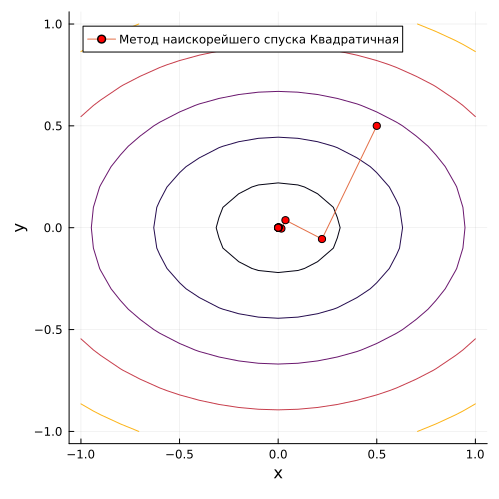

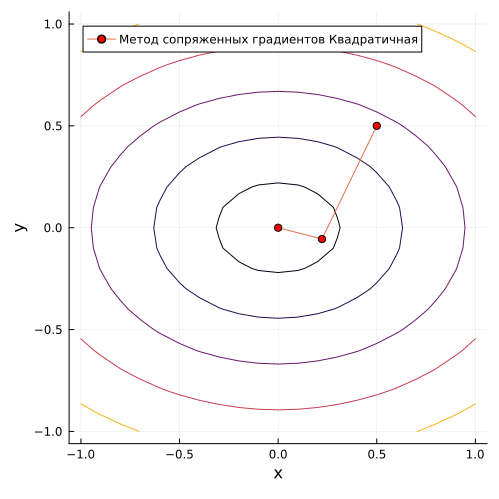

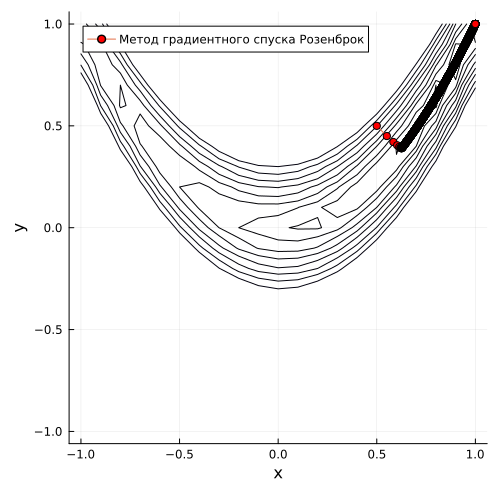

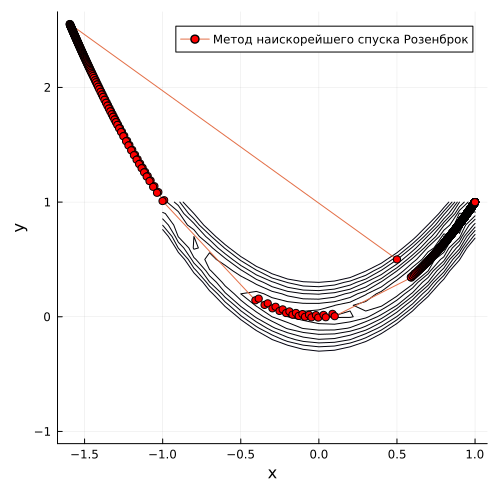

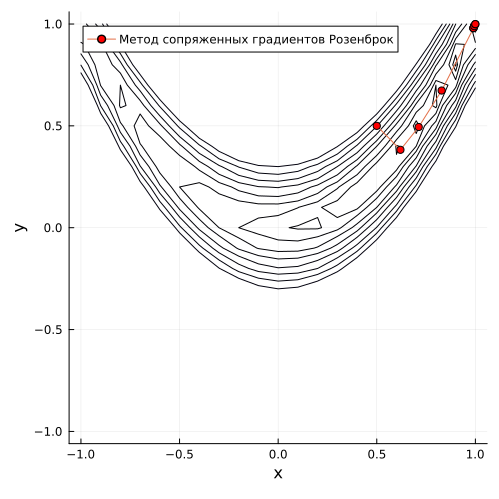

...

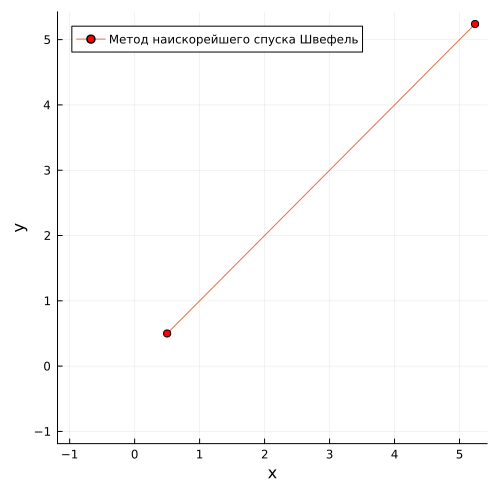

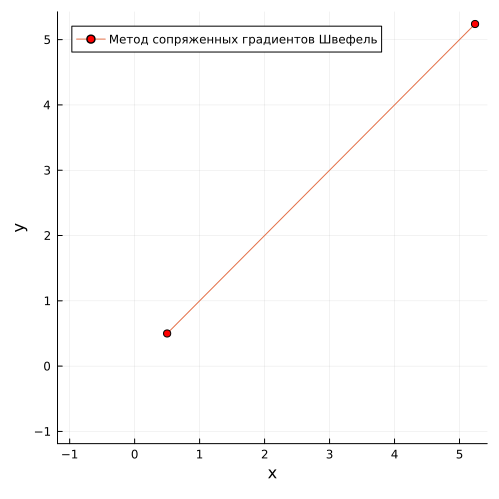

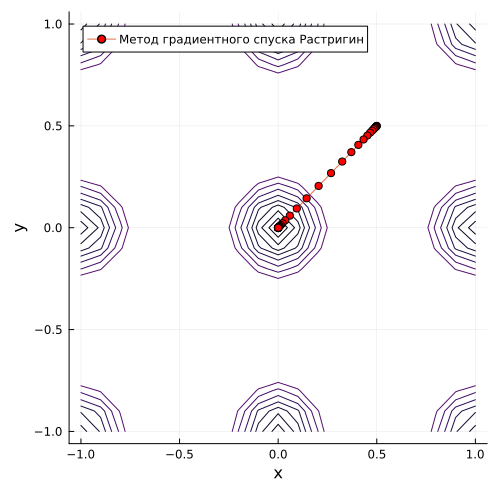

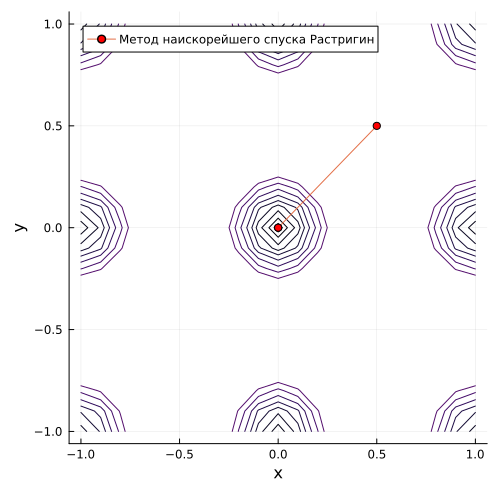

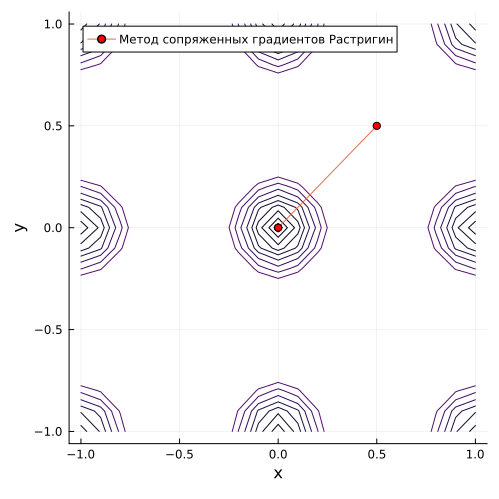

In [18]:
using LinearAlgebra
using Plots

gr()

function numerical_gradient(f, x, eps=1e-8)
    grad = zeros(length(x))
    for i in 1:length(x)
        x_step = copy(x)
        x_step[i] += eps
        grad[i] = (f(x_step) - f(x)) / eps
    end
    return grad
end

function gradient_descent(f, x0; lr=1e-3, tol=1e-6, max_iters=100000)
    x = copy(x0)
    xs = []
    push!(xs, x)
    for iter in 1:max_iters
        grad = numerical_gradient(f, x)
        if norm(grad) < tol
            break
        end
        x -= lr * grad
        push!(xs, x)
    end
    return x, xs
end

x0 = [0.5, 0.5]

function testF(x; a=1.0, b=2.0)
    return a * (x[1])^2 + b * (x[2])^2
end

function rosenbrock(x)
    return (1 - x[1])^2 + 100 * (x[2] - x[1]^2)^2
end

function schwefel(x)
    return 418.9829 * 2 - (x[1] * sin(sqrt(abs(x[1]))) + x[2] * sin(sqrt(abs(x[2]))))
end

function rastrigin(x)
    return 20 + sum(x.^2 .- 10 * cos.(2 * π * x))
end

function df(f, x::Vector{Float64}, i, h=1e-5)
    x_plus = copy(x)
    x_minus = copy(x)
    
    x_plus[i] += h
    x_minus[i] -= h
    
    df_dx = (f(x_plus) - f(x_minus)) / (2h)
    
    return df_dx
end

function gradient(f, x::Vector{Float64})
    grad = []
    for i in 1:length(x)
        push!(grad, df(f, x, i))
    end
    return grad
end

function swann_method(f, x0, h=0.1)
    first = x0
    second = x0 + h

    if f(second) > f(first)
        h = -h
        first, second = second, second + h
    end
    last = second + h
    
    while f(last) < f(second)
        h *= 2
        first, second, last = second, last, last + h
    end

    if second > last
        first, second, last = last, second, first
    end

    return first, last
end

function golden_section_search(f, a, b, eps=1e-5)
    phi = (sqrt(5) - 1) / 2 
    x1 = b - phi * (b - a)
    x2 = a + phi * (b - a)
    
    while abs(b - a) > eps
        if f(x1) <= f(x2)
            b = x2
        else
            a = x1
        end
        x1 = b - phi * (b - a)
        x2 = a + phi * (b - a)
    end
    
    return (a + b) / 2
end

function gradient_fast_descent(f, x0)
    eps1, eps2 = 1e-6, 1e-10
    x = x0
    trajectory = [copy(x)]
    
    while true
        grad = gradient(f, x)  
        prev_grad = copy(grad)
        l, r = swann_method(alpha -> f(x - alpha * grad), 1e-2)
        alpha = golden_section_search(alpha -> f(x - alpha * grad), l, r)
        
        x_new = x - alpha * grad

        if norm(x - x_new) < eps1 || norm(f(x) - f(x_new)) < eps2
            break
        end
        
        x = x_new
        push!(trajectory, copy(x))
            
        if dot(prev_grad, gradient(f, x)) > 1
            println("not ortogonal")
        end
    end
    return x, trajectory
end

function conjugate_gradient(f, x0)
    eps1, eps2 = 1e-6, 1e-10
    x = x0
    prev_x = copy(x)
    grad = gradient(f, x)
    d = -grad
    trajectory = [x]
    
    while true
        prev_grad=copy(grad)
        l, r = swann_method(alpha -> f(x + alpha * d), 1e-7)
        alpha = golden_section_search(alpha -> f(x + alpha * d), l, r)
        x += alpha * d
        grad = gradient(f, x)

        if norm(x - prev_x) < eps1 || norm(f(x) - f(prev_x)) < eps2
            break
        end

        beta = dot(grad, grad) / dot(prev_grad, prev_grad)
        d = -grad + beta * d
        prev_x = copy(x)
        push!(trajectory, x)
    end
    
    return x, trajectory
end

function plot_function_contours(f, func_name)
    x0 = [0.5, 0.5]
    x = -1:0.1:1
    y = -1:0.1:1
    levels = []
    for i in 1:10
        push!(levels, i^2*0.1)
    end

    x_min, trajectory = gradient_descent(f, x0)
    println("[МГС] Точка минимума: ", x_min, "; Количество итераций: ", length(trajectory)-1)

    x_coords = [point[1] for point in trajectory]
    y_coords = [point[2] for point in trajectory]

    p0 = Plots.contour(x, y, (x, y) -> f([x, y]), levels = levels, xlabel="x", ylabel="y", colorbar=false, size=(500, 500))
    plot!(p0, x_coords, y_coords, label="Метод градиентного спуска $func_name", marker=:red)
    
    display(p0)

    x_min, trajectory = gradient_fast_descent(f, x0)
    println("[МНС] Точка минимума: ", x_min, "; Количество итераций: ", length(trajectory)-1)

    x_coords = [point[1] for point in trajectory]
    y_coords = [point[2] for point in trajectory]

    p1 = Plots.contour(x, y, (x, y) -> f([x, y]), levels = levels, xlabel="x", ylabel="y", colorbar=false, size=(500, 500))
    plot!(p1, x_coords, y_coords, label="Метод наискорейшего спуска $func_name", marker=:red)
    
    display(p1)

    x_min, trajectory = conjugate_gradient(f, x0)
    println("[МСГ] Точка минимума: ", x_min, "; Количество итераций: ", length(trajectory)-1)

    x_coords = [point[1] for point in trajectory]
    y_coords = [point[2] for point in trajectory]

    p2 = Plots.contour(x, y, (x, y) -> f([x, y]), levels = levels, xlabel="x", ylabel="y", colorbar=false, size=(500, 500))
    plot!(p2, x_coords, y_coords, label="Метод сопряженных градиентов $func_name", marker=:red)
    
    display(p2)
end

plot_function_contours(testF, "Квадратичная")
plot_function_contours(rosenbrock, "Розенброк")
plot_function_contours(schwefel, "Швефель")
plot_function_contours(rastrigin, "Растригин")